# Goal

- The goal of this visualization project is to provide a comprehensive understanding of the complex issue of violence in New York City. By visually representing the data related to murders per 100 shootings in each borough, age and race distribution of perpetrators, shootings in each hour of the day, and months with the highest shootings, the project aims to:
    - Identify high crime areas 
    - Highlight demographic patterns
    - Identify temporal patterns


- I have always known New York City (NYC) as the center of the world known for its vibrant energy, diversity and opportunities. I want to move there but time and again you hear many problems of the city particularly gun violence being the most concerning. Therefore, through this visualization project I want to understand the complex dynamics of gun violence in the city which could provide some meaningful insights. These insights could help stakeholders to guide taking data-driven interventions.

(Reference: Inspiration from chatgpt (https://chat.openai.com/))

# Data Acquistion
Data Resource: https://data.cityofnewyork.us/Public-Safety/NYPD-Shooting-Incident-Data-Historic-/833y-fsy8
- The data is obtained from the NYC Open Data that lists every shooting incident that occurred in NYC going back to 2006 through the end of the previous calendar year.
- The data is provided by the New York Police Department (NYPD) who is the original source of the data.
- This data is manually extracted every quarter and reviewed by the Office of Management Analysis and Planning before being posted on the NYPD website.
- The NYC Open Data platform from where this dataset is extracted has no mention of license indicating it is intended for public use.  
- There are 21 columns/features in the data including geographical information (latitude-longitude).
- Among all these features, this visualization project has used the following:
    - INCIDENT_KEY: Randomly generated persistent ID for each arrest
    - OCCUR_DATE: Exact date of the shooting incident
    - OCCUR TIME: Exact time of the shooting incident
    - BORO: Borough where the shooting incident occurred
    - STATISTICAL_MURDER_FLAG: Shooting resulted in the victim’s death which would be counted as a murder
    - PERP_AGE_GROUP: Perpetrator’s age within a category
    - PERP_SEX: Perpetrator’s sex description
    - PERP_RACE: Perpetrator’s race description
    - Latitude: Latitude coordinate for Global Coordinate System, WGS 1984, decimal degrees (EPSG 4326)
    - Longitude: Longitude coordinate for Global Coordinate System, WGS 1984, decimal degrees (EPSG 4326)

- Another dataset called **'nybb'** with geoinformation from geopandas is also used and merged with the main dataset for one geo plot.

# Data Processing

### Import libraries

In [1]:
import geopandas as gpd
import pandas as pd
import altair as alt
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.ticker as mticker
import numpy as np

pd.set_option('display.max.columns',None)
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

### Initial Data Analysis

In [2]:
df = pd.read_csv('NYPD_Shooting_Incident_Data__Historic_.csv')
df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,228798151,05/27/2021,21:30:00,QUEENS,NaN,105,0.0,NaN,NaN,False,NaN,NaN,NaN,18-24,M,BLACK,1.058925e+06,180924.000000,40.662965,-73.730839,POINT (-73.73083868899994 40.662964620000025)
1,137471050,06/27/2014,17:40:00,BRONX,NaN,40,0.0,NaN,NaN,False,NaN,NaN,NaN,18-24,M,BLACK,1.005028e+06,234516.000000,40.810352,-73.924942,POINT (-73.92494232599995 40.81035186300006)
2,147998800,11/21/2015,03:56:00,QUEENS,NaN,108,0.0,NaN,NaN,True,NaN,NaN,NaN,25-44,M,WHITE,1.007668e+06,209836.531250,40.742607,-73.915492,POINT (-73.91549174199997 40.74260663300004)
3,146837977,10/09/2015,18:30:00,BRONX,NaN,44,0.0,NaN,NaN,False,NaN,NaN,NaN,<18,M,WHITE HISPANIC,1.006537e+06,244511.140625,40.837782,-73.919457,POINT (-73.91945661499994 40.83778200300003)
4,58921844,02/19/2009,22:58:00,BRONX,NaN,47,0.0,NaN,NaN,True,25-44,M,BLACK,45-64,M,BLACK,1.024922e+06,262189.406250,40.886238,-73.852910,POINT (-73.85290950899997 40.88623791800006)


In [3]:
df.shape

(27312, 21)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27312 entries, 0 to 27311
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   INCIDENT_KEY             27312 non-null  int64  
 1   OCCUR_DATE               27312 non-null  object 
 2   OCCUR_TIME               27312 non-null  object 
 3   BORO                     27312 non-null  object 
 4   LOC_OF_OCCUR_DESC        1716 non-null   object 
 5   PRECINCT                 27312 non-null  int64  
 6   JURISDICTION_CODE        27310 non-null  float64
 7   LOC_CLASSFCTN_DESC       1716 non-null   object 
 8   LOCATION_DESC            12335 non-null  object 
 9   STATISTICAL_MURDER_FLAG  27312 non-null  bool   
 10  PERP_AGE_GROUP           17968 non-null  object 
 11  PERP_SEX                 18002 non-null  object 
 12  PERP_RACE                18002 non-null  object 
 13  VIC_AGE_GROUP            27312 non-null  object 
 14  VIC_SEX               

In [5]:
df.isna().sum()

INCIDENT_KEY                   0
OCCUR_DATE                     0
OCCUR_TIME                     0
BORO                           0
LOC_OF_OCCUR_DESC          25596
PRECINCT                       0
JURISDICTION_CODE              2
LOC_CLASSFCTN_DESC         25596
LOCATION_DESC              14977
STATISTICAL_MURDER_FLAG        0
PERP_AGE_GROUP              9344
PERP_SEX                    9310
PERP_RACE                   9310
VIC_AGE_GROUP                  0
VIC_SEX                        0
VIC_RACE                       0
X_COORD_CD                     0
Y_COORD_CD                     0
Latitude                      10
Longitude                     10
Lon_Lat                       10
dtype: int64

**Dropping rows having same incident_key since it is unique for each incident**

In [6]:
df = df.drop_duplicates(subset=['INCIDENT_KEY'])

**Convert OCCUR_DATE into datetime format to use them in x-axis as a time datatype in altair for the first plot below**

In [7]:
df['OCCUR_DATE'] = pd.to_datetime(df['OCCUR_DATE'], format='mixed')

**Create new column 'hour' using OCCURE_TIME to get the hour of the incident which will be the used later on in x-axis in the 2nd plot below**

In [8]:
df['OCCUR_TIME'] = pd.to_datetime(df['OCCUR_TIME'], format='mixed')
df['hour'] = df['OCCUR_TIME'].dt.hour

**Replacing and handling null/unknown/invalid values in the features 'PERP_RACE' and 'PERP_AGE_GROUP' for better visualization of their categories in the 3rd plot**

In [9]:
df['PERP_RACE'].value_counts()

PERP_RACE
BLACK                             8430
UNKNOWN                           1621
WHITE HISPANIC                    1537
BLACK HISPANIC                     899
(null)                             525
WHITE                              218
ASIAN / PACIFIC ISLANDER            98
AMERICAN INDIAN/ALASKAN NATIVE       2
Name: count, dtype: int64

In [10]:
df['PERP_RACE'] = df['PERP_RACE'].replace({'UNKNOWN':np.nan,'(null)':np.nan})

In [11]:
df['PERP_AGE_GROUP'].value_counts()

PERP_AGE_GROUP
18-24      4372
25-44      4097
UNKNOWN    2736
<18        1094
(null)      525
45-64       427
65+          46
940           1
224           1
1020          1
Name: count, dtype: int64

In [12]:
df['PERP_AGE_GROUP'] = df['PERP_AGE_GROUP'].replace({'UNKNOWN':np.nan, '(null)': np.nan, '940':np.nan,'224':np.nan, '1020':np.nan})

**Create geodataframe to visualize murders per shootings in different boroughs of NYC in the 4th plot. The geodataframe would have the following useful information**

- Borough
- Incident count
- Murder count
- Murder per 100 shootings/incident
- Geometry of each borough

In [13]:
# groupby the data to get count of all incidents based on borough and statistical murder flag 
grp = df.groupby(['BORO','STATISTICAL_MURDER_FLAG'])['INCIDENT_KEY'].count()
grp = grp.reset_index()

# groupby the data based on borough to cound incident key and create a dataframe
incident_grp = df.groupby(['BORO'])['INCIDENT_KEY'].count()
incident_grp = incident_grp.reset_index()
incident_grp = incident_grp.rename(columns={'INCIDENT_KEY':'incident_count'})

# create a dataframe for incidents that are murders
murder_grp = grp[grp['STATISTICAL_MURDER_FLAG']==True]
murder_grp = murder_grp.drop(columns='STATISTICAL_MURDER_FLAG')
murder_grp = murder_grp.rename(columns={'INCIDENT_KEY':'murder_count'})

# dataframe for showing murders per 100 shootings, total no of shootings (murder/murderless) and borough
shootings_df = incident_grp.merge(murder_grp,how='inner',on='BORO')
shootings_df['Murders_Per_100_Shootings'] = (shootings_df['murder_count'] / shootings_df['incident_count']*100)

# merge shootings df and nybb dataset to create a geodataframe
ny = gpd.read_file(gpd.datasets.get_path('nybb'))
ny['BoroName'] = ny['BoroName'].apply(lambda x:x.upper())
ny = ny.rename(columns={'BoroName':'BORO'})
ny_shootings = shootings_df.merge(ny,how='inner',on='BORO')
gdf = gpd.GeoDataFrame(ny_shootings)
gdf

/tmp/ipykernel_11476/3046943463.py:20: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'nybb' data from the geodatasets package.

from geodatasets import get_path
path_to_file = get_path('nybb')

  ny = gpd.read_file(gpd.datasets.get_path('nybb'))


,BORO,incident_count,murder_count,Murders_Per_100_Shootings,BoroCode,Shape_Leng,Shape_Area,geometry
0,BRONX,6019,1018,16.913108,2,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278..."
1,BROOKLYN,8806,1572,17.851465,3,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100..."
2,MANHATTAN,2747,433,15.762650,1,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940...."
3,QUEENS,3229,592,18.333849,4,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957..."
4,STATEN ISLAND,619,118,19.063005,5,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227...."


# Visual Story

#### 1) Rectangle plot to show incidents based on month and the year

In [14]:
alt.Chart(df).mark_rect().encode(
    alt.X('month(OCCUR_DATE):T',axis=alt.Axis(tickCount='month')).title('Month'),
    alt.Y('year(OCCUR_DATE):T').title('Year'),
    alt.Color('count():Q', scale=alt.Scale(scheme='reds')).title('Number of incidents')
).properties(
    width=800,
    height=400,
    title={
        'text': 'Incidents on each month from 2006-2022',
        'fontSize': 16,
        'anchor': 'middle',
    })

alt.Chart(...)

- From the above plot, it can be observed that high tempered months have higher incidents/shootings compared to colder months
- The month of July has the most shootings in all months throughout years (2006-2022)

#### 2) Area plot to show incidents by hour throughout 2006-2022

In [15]:
# Group the data by hour and count the number of crimes for each hour
hourly_crimes = df.groupby(['hour','BORO']).size().reset_index(name='count')

alt.Chart(hourly_crimes).mark_area().encode(
    x=alt.X('hour:O').title('Hour'),  # Ordinal encoding for the hour
    y=alt.Y('count:Q').title('No of Incidents'),
    color=alt.Color("BORO:N", scale=alt.Scale(scheme='tableau10')).title('Borough')
).configure_axis(
    grid=True  # Display gridlines
).configure_axisX(
    labelAngle=0
).configure_view(
    strokeWidth=0  # Remove chart border
).properties(
    width=800,
    height=400,
    title={
        'text': 'Incidents by hour (2006-2022)',
        'fontSize': 16,
        'anchor': 'middle',
    }
)

alt.Chart(...)

- From the above plot, it is evident that the night time is the most vulnerable time for shootings, while morning time (6-mid day) has the least number of shootings.
- This pattern is followed on every borough of NYC.
- Another observation is that Bronx has the highest no of incidents among all.

#### 3) Barplot to show perpetrator ethinicity and age distribution

In [16]:
# list of order for showing ages in the barplot 
x_order = ['<18','18-24','25-44','45-64','65+']

alt.Chart(df).mark_bar().encode(
    x=alt.X('count(INCIDENT_KEY)').title('No of Incidents'),
    y=alt.Y('PERP_AGE_GROUP',sort=x_order).title('Age Group'),
    color=alt.Color('PERP_RACE',scale=alt.Scale(scheme='tableau10')).title('Ethinicity')
).transform_filter(
    'isValid(datum.PERP_RACE)'
).transform_filter(
    'isValid(datum.PERP_AGE_GROUP)'
).properties(
    width=800,
    height=400,
    title={
        'text': 'Perpetrator ethinicity and age distribution',
        'fontSize': 16,
        'anchor': 'middle',
    }
)

alt.Chart(...)

- The above plot visualizes the distribution of the race and age group of shootings perpetrators.
- It is observed that majority of perpetrators are from the age 18 to 44 years.
- Majority of perpetrators belong to Black ethinicity followed by White Hispanic in each age group

#### 4) Geo plot to show murders per 100 shootings in different boroughs of New York City

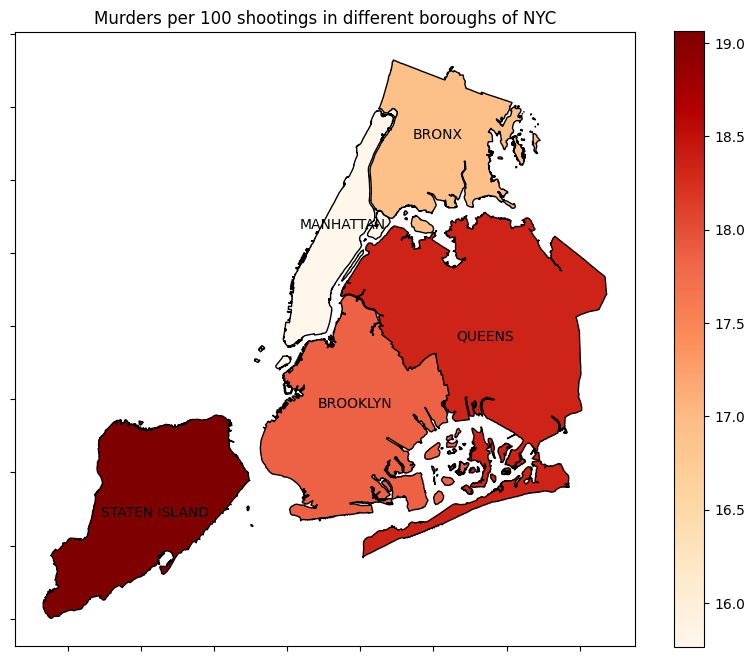

In [17]:
# create 'coords' column in geodataframe to add borough name in the geo plot
gdf['coords'] = gdf['geometry'].apply(lambda x: x.representative_point().coords[:])
gdf['coords'] = [coords[0] for coords in gdf['coords']]

fig, ax = plt.subplots(figsize=(10, 8))
plt.title('Murders per 100 shootings in different boroughs of NYC')
gdf.plot(column='Murders_Per_100_Shootings', legend=True,cmap='OrRd',ax=ax, edgecolor='k');

# to annonate borough name in the graph
for idx, row in gdf.iterrows():
    plt.annotate(text=row['BORO'], xy=row['coords'],
                 horizontalalignment='center')
    
ax.set_xticklabels([])
ax.set_yticklabels([])

plt.show()

- The above plot visualizes the average murder rates per 100 shootings/incidents in different boroughs of NYC.
- It is observed that the Staten Island has the highest murder rate/100 shootings among all boroughs.
- Manhatten has the least murder rate/100 shootings in NYC probably due to its better emergency medical facilities and high no of precints.

# Conclusion

**Summary:**

- From above plots, I have interpreted some of the factors that help to understand some patterns of gun violence in NYC. 
- Shootings number increases during hot climate months and several studies have concluded that there exists a positive correlation between them. However, there is no evidence for the casual effect between them yet. With this interpretation, the NYPD or city government could plan their resources efficiently.
- The night time is the most vulnerable time of shooting incidents no matter which borough and this is reassured by the area plot.
- Surprisingly, Staten Island has the highest murders/100 shootings in all NYC even though their total no of incidents is relatively quite low. So, in Staten Island more precints and effective medical facilities can help reduce the rate.
- And, NYC has reflected the ethinicity pattern of perpetrators like it is in the entire USA. Black perpertrators are the majority to be involved in shooting crimes. This gives not just city but federal government an evidence to accept the problem and find a solid solution for it. It is evident that the black community needs help and if policies are made to uplift their social and economic situations, then the violence number would decrease significantly.

**Limitation:**

- This project has quite a huge prepetrator data missing (~9300 out of ~21000), so the general profile or distribution of a perpetrator based on race and age might be overly biased/generalized towards a certain group. And, this might change with correct values on missing records.
- This project emphasized more on incident itself but not on it's effect i.e. victims' stories are missing.
- Some of the plots are showcasing multiple information/interpretation which might overwhelm to lay men.

**Future Work**
- We can investigate more on victims to visualize their story.
- We can integrate geo information for more plots.
- We can investigate about the missing data and think of ways to impute and make it more accurate so that we have a right story/interpretation.